In [42]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf
from sklearn.model_selection import train_test_split


## 2-A

In [43]:
df=pd.read_csv("weatherHistory.csv")
df['Formatted Date'] = df['Formatted Date'].map(lambda x: x.rstrip('021+ '))
df['Formatted Date'] = df['Formatted Date'].str.replace(r'\.', '', regex=True)
df['Formatted Date'] = pd.to_datetime(df['Formatted Date']).dt.date
# df['Formatted Date']=pd.to_datetime(df['Formatted Date'], format='%Y-%m-%d %H:%M:%S')
df['DayOfYear']=df['Formatted Date'].copy()

for i in range(len(df[ "Formatted Date"])):
    if df[ "Formatted Date"][i].year!=2008 and df[ "Formatted Date"][i].year!=2012 and df[ "Formatted Date"][i].year!=2016:
        a=0
    else:
        a=1
    if df[ "Formatted Date"][i].month==1:
        df['DayOfYear'][i]=df["Formatted Date"][i].day
    elif df[ "Formatted Date"][i].month==2:
        df['DayOfYear'][i]=df["Formatted Date"][i].day+31
    elif df[ "Formatted Date"][i].month==3:
        df['DayOfYear'][i]=df["Formatted Date"][i].day+59+a
    elif df[ "Formatted Date"][i].month==4:
        df['DayOfYear'][i]=df["Formatted Date"][i].day+90+a
    elif df[ "Formatted Date"][i].month==5:
        df['DayOfYear'][i]=df["Formatted Date"][i].day+120+a
    elif df[ "Formatted Date"][i].month==6:
        df['DayOfYear'][i]=df["Formatted Date"][i].day+151+a
    elif df[ "Formatted Date"][i].month==7:
        df['DayOfYear'][i]=df["Formatted Date"][i].day+181+a
    elif df[ "Formatted Date"][i].month==8:
        df['DayOfYear'][i]=df["Formatted Date"][i].day+212+a
    elif df[ "Formatted Date"][i].month==9:
        df['DayOfYear'][i]=df["Formatted Date"][i].day+243+a
    elif df[ "Formatted Date"][i].month==10:
        df['DayOfYear'][i]=df["Formatted Date"][i].day+273+a
    elif df[ "Formatted Date"][i].month==11:
        df['DayOfYear'][i]=df["Formatted Date"][i].day+304+a
    elif df[ "Formatted Date"][i].month==12:
        df['DayOfYear'][i]=df["Formatted Date"][i].day+334+a
df['DayOfYear']

C:\Users\Alireza\AppData\Local\Temp\ipykernel_1736\2228161786.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['DayOfYear'][i]=df["Formatted Date"][i].day+90+a
C:\Users\Alireza\AppData\Local\Temp\ipykernel_1736\2228161786.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['DayOfYear'][i]=df["Formatted Date"][i].day+90+a
C:\Users\Alireza\AppData\Local\Temp\ipykernel_1736\2228161786.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus

0         91
1         91
2         91
3         91
4         91
        ... 
96448    253
96449    253
96450    253
96451    253
96452    253
Name: DayOfYear, Length: 96453, dtype: object

In [44]:
df

,Formatted Date,Summary,Precip Type,Temperature (C),Apparent Temperature (C),Humidity,Wind Speed (km/h),Wind Bearing (degrees),Visibility (km),Loud Cover,Pressure (millibars),Daily Summary,DayOfYear
0,2006-04-01,Partly Cloudy,rain,9.472222,7.388889,0.89,14.1197,251.0,15.8263,0.0,1015.13,Partly cloudy throughout the day.,91
1,2006-04-01,Partly Cloudy,rain,9.355556,7.227778,0.86,14.2646,259.0,15.8263,0.0,1015.63,Partly cloudy throughout the day.,91
2,2006-04-01,Mostly Cloudy,rain,9.377778,9.377778,0.89,3.9284,204.0,14.9569,0.0,1015.94,Partly cloudy throughout the day.,91
3,2006-04-01,Partly Cloudy,rain,8.288889,5.944444,0.83,14.1036,269.0,15.8263,0.0,1016.41,Partly cloudy throughout the day.,91
4,2006-04-01,Mostly Cloudy,rain,8.755556,6.977778,0.83,11.0446,259.0,15.8263,0.0,1016.51,Partly cloudy throughout the day.,91
...,...,...,...,...,...,...,...,...,...,...,...,...,...
96448,2016-09-09,Partly Cloudy,rain,26.016667,26.016667,0.43,10.9963,31.0,16.1000,0.0,1014.36,Partly cloudy starting in the morning.,253
96449,2016-09-09,Partly Cloudy,rain,24.583333,24.583333,0.48,10.0947,20.0,15.5526,0.0,1015.16,Partly cloudy starting in the morning.,253
96450,2016-09-09,Partly Cloudy,rain,22.038889,22.038889,0.56,8.9838,30.0,16.1000,0.0,1015.66,Partly cloudy starting in the morning.,253
96451,2016-09-09,Partly Cloudy,rain,21.522222,21.522222,0.60,10.5294,20.0,16.1000,0.0,1015.95,Partly cloudy starting in the morning.,253


In [45]:
df.drop(['Daily Summary','Summary','Precip Type'], axis=1, inplace=True)

In [46]:
for i in df.columns:
    print(i)

Formatted Date
Temperature (C)
Apparent Temperature (C)
Humidity
Wind Speed (km/h)
Wind Bearing (degrees)
Visibility (km)
Loud Cover
Pressure (millibars)
DayOfYear


In [47]:
data=df.groupby('Formatted Date')['Temperature (C)'].mean().reset_index()
for i in df.columns:
    if i!='Formatted Date' and i!='Temperature (C)':
        mean_temp1=df.groupby('Formatted Date')[i].mean().reset_index()
        data = pd.concat([data, mean_temp1[i]], axis=1, join='inner')
data


,Formatted Date,Temperature (C),Apparent Temperature (C),Humidity,Wind Speed (km/h),Wind Bearing (degrees),Visibility (km),Loud Cover,Pressure (millibars),DayOfYear
0,2006-01-01,3.873148,-0.447222,0.818333,21.372750,142.041667,11.112354,0.0,1012.279167,1.0
1,2006-01-02,5.418519,2.042593,0.844583,17.551683,161.958333,8.956967,0.0,1010.131667,2.0
2,2006-01-03,2.319444,0.223843,0.898333,8.417617,248.541667,9.011975,0.0,1020.805000,3.0
3,2006-01-04,2.274074,-0.457407,0.905417,11.579925,46.916667,8.339129,0.0,981.826667,4.0
4,2006-01-05,2.698148,0.256481,0.948333,9.515100,140.375000,4.628750,0.0,935.988333,5.0
...,...,...,...,...,...,...,...,...,...,...
4013,2016-12-27,0.280324,-3.158102,0.890000,10.980200,185.875000,7.303362,0.0,1020.304583,362.0
4014,2016-12-28,0.224306,-3.223611,0.890000,10.969467,186.166667,7.304704,0.0,1020.334583,363.0
4015,2016-12-29,0.169676,-3.268056,0.889583,10.892992,186.041667,7.309400,0.0,1020.365833,364.0
4016,2016-12-30,0.119444,-3.306019,0.889167,10.806454,186.041667,7.316779,0.0,1020.395000,365.0


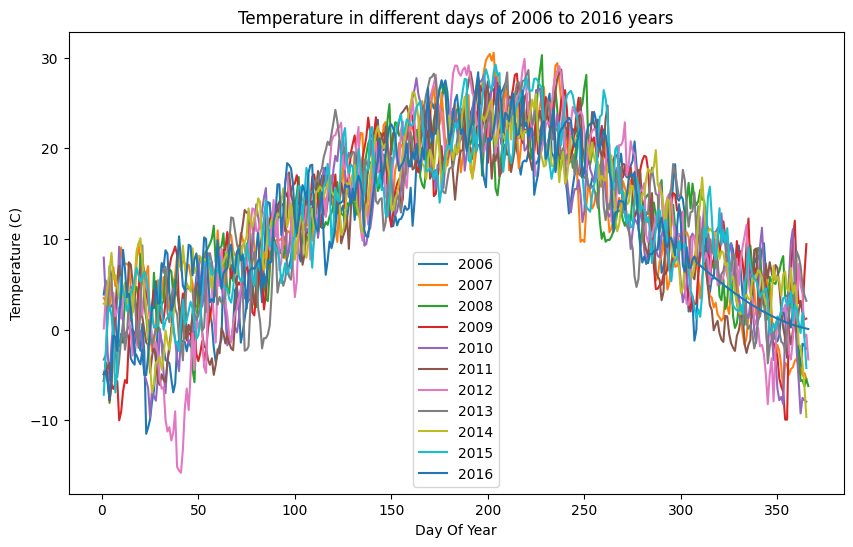

In [48]:
# pd.to_datetime(data['Formatted Date']).dt.year==2006
data['Formatted Date']=pd.to_datetime(data['Formatted Date'])
plt.figure(figsize=(10,6))
for i in range(2006,2017):
    q=data.loc[data['Formatted Date'].dt.year==i]
    plt.plot(q['DayOfYear'],q['Temperature (C)'],label=f'{i}')

plt.xlabel('Day Of Year')
plt.ylabel('Temperature (C)')
plt.legend()
plt.title("Temperature in different days of 2006 to 2016 years")
plt.show()


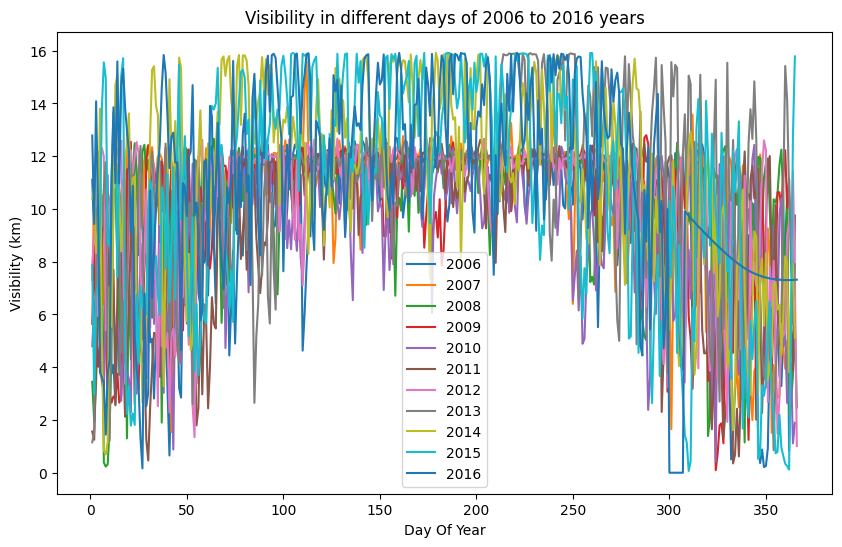

In [49]:
# pd.to_datetime(data['Formatted Date']).dt.year==2006
data['Formatted Date']=pd.to_datetime(data['Formatted Date'])
plt.figure(figsize=(10,6))
for i in range(2006,2017):
    q=data.loc[data['Formatted Date'].dt.year==i]
    plt.plot(q['DayOfYear'],q['Visibility (km)'],label=f'{i}')

plt.xlabel('Day Of Year')
plt.ylabel('Visibility (km)')
plt.legend()
plt.title("Visibility in different days of 2006 to 2016 years")
plt.show()

## 2_B: MLP

In [50]:
data

,Formatted Date,Temperature (C),Apparent Temperature (C),Humidity,Wind Speed (km/h),Wind Bearing (degrees),Visibility (km),Loud Cover,Pressure (millibars),DayOfYear
0,2006-01-01,3.873148,-0.447222,0.818333,21.372750,142.041667,11.112354,0.0,1012.279167,1.0
1,2006-01-02,5.418519,2.042593,0.844583,17.551683,161.958333,8.956967,0.0,1010.131667,2.0
2,2006-01-03,2.319444,0.223843,0.898333,8.417617,248.541667,9.011975,0.0,1020.805000,3.0
3,2006-01-04,2.274074,-0.457407,0.905417,11.579925,46.916667,8.339129,0.0,981.826667,4.0
4,2006-01-05,2.698148,0.256481,0.948333,9.515100,140.375000,4.628750,0.0,935.988333,5.0
...,...,...,...,...,...,...,...,...,...,...
4013,2016-12-27,0.280324,-3.158102,0.890000,10.980200,185.875000,7.303362,0.0,1020.304583,362.0
4014,2016-12-28,0.224306,-3.223611,0.890000,10.969467,186.166667,7.304704,0.0,1020.334583,363.0
4015,2016-12-29,0.169676,-3.268056,0.889583,10.892992,186.041667,7.309400,0.0,1020.365833,364.0
4016,2016-12-30,0.119444,-3.306019,0.889167,10.806454,186.041667,7.316779,0.0,1020.395000,365.0


In [51]:
data.corr()

,Formatted Date,Temperature (C),Apparent Temperature (C),Humidity,Wind Speed (km/h),Wind Bearing (degrees),Visibility (km),Loud Cover,Pressure (millibars),DayOfYear
Formatted Date,1.000000,0.033440,0.033730,0.064660,-0.018462,-0.043753,0.130480,NaN,0.023316,0.091317
Temperature (C),0.033440,1.000000,0.995747,-0.590622,-0.139730,0.051811,0.575520,NaN,-0.000665,0.158705
Apparent Temperature (C),0.033730,0.995747,1.000000,-0.573652,-0.190833,0.050287,0.554627,NaN,0.006784,0.167355
Humidity,0.064660,-0.590622,-0.573652,1.000000,-0.059326,-0.017147,-0.693664,NaN,-0.006716,0.084541
Wind Speed (km/h),-0.018462,-0.139730,-0.190833,-0.059326,1.000000,0.159346,0.196635,NaN,-0.085750,-0.136642
Wind Bearing (degrees),-0.043753,0.051811,0.050287,-0.017147,0.159346,1.000000,0.099641,NaN,-0.043628,-0.031238
Visibility (km),0.130480,0.575520,0.554627,-0.693664,0.196635,0.099641,1.000000,NaN,0.056049,-0.097194
Loud Cover,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Pressure (millibars),0.023316,-0.000665,0.006784,-0.006716,-0.085750,-0.043628,0.056049,NaN,1.000000,-0.033029
DayOfYear,0.091317,0.158705,0.167355,0.084541,-0.136642,-0.031238,-0.097194,NaN,-0.033029,1.000000


In [66]:


X=data[['DayOfYear','Visibility (km)','Humidity']].astype('int')
Y=data[['Temperature (C)']].astype('int')

X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2)

In [53]:
model = tf.keras.models.Sequential([
  tf.keras.layers.Dense(3, activation=tf.keras.activations.relu),  #  input layer
  tf.keras.layers.Dense(9, activation=tf.keras.activations.relu),    #  hidden layer 1
  tf.keras.layers.Dense(3, activation=tf.keras.activations.relu),    #  hidden layer 2
  tf.keras.layers.Dense(1, activation='linear')     # output layer
])

In [54]:
model.compile(optimizer=tf.keras.optimizers.AdamW(learning_rate=0.001),
              loss='mae' )

In [55]:
output=model.fit(X_train,Y_train,epochs=150)

Epoch 1/150


101/101 [==============================] - 1s 2ms/step - loss: 12.6313
Epoch 2/150
101/101 [==============================] - 0s 2ms/step - loss: 7.9404
Epoch 3/150
101/101 [==============================] - 0s 2ms/step - loss: 7.8761
Epoch 4/150
101/101 [==============================] - 0s 2ms/step - loss: 7.7998
Epoch 5/150
101/101 [==============================] - 0s 2ms/step - loss: 7.7378
Epoch 6/150
101/101 [==============================] - 0s 2ms/step - loss: 7.6330
Epoch 7/150
101/101 [==============================] - 0s 2ms/step - loss: 7.5051
Epoch 8/150
101/101 [==============================] - 0s 2ms/step - loss: 7.4198
Epoch 9/150
101/101 [==============================] - 0s 1ms/step - loss: 7.2369
Epoch 10/150
101/101 [==============================] - 0s 1ms/step - loss: 7.0018
Epoch 11/150
101/101 [==============================] - 0s 1ms/step - loss: 6.7229
Epoch 12/150
101/101 [==============================] - 0s 1ms/step - loss: 6.2794
Epoch 13/150
101/101 [==

## 2_C: evaluate:   loss of validation data of weather prediction 

In [67]:
loss=model.evaluate(X_test,Y_test)
print(f'loss of validation data of weather prediction: {loss}')

26/26 [==============================] - 0s 1ms/step - loss: 3.3204
loss of validation data of weather prediction: 3.3204169273376465


## 2_D: predict

In [57]:
temp=model.predict([[350,8,0.8]])
temp

1/1 [==============================] - 0s 124ms/step


array([[6.002824]], dtype=float32)

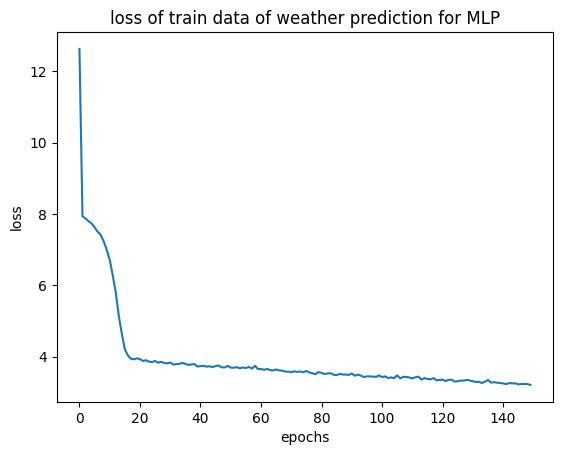

In [59]:
loss=output.history['loss']
plt.plot(loss)
plt.xlabel("epochs")
plt.ylabel('loss')
plt.title("loss of train data of weather prediction for MLP")
plt.show()

In [60]:

data['Formatted Date']=pd.to_datetime(data['Formatted Date'])

a=data.loc[data['Formatted Date'].dt.year==2006]


Y_pred=[]
for i,j,k in zip(a['DayOfYear'],a['Visibility (km)'],a['Humidity']):
    Y_pred.append(model.predict([[i,j,k]]))





1/1 [==============================] - 0s 38ms/step


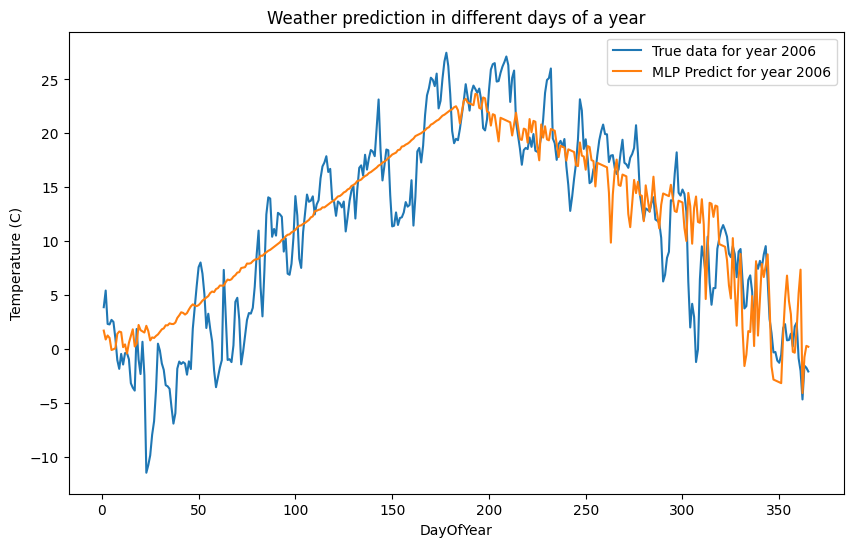

In [61]:
plt.figure(figsize=(10,6))
plt.plot(a['DayOfYear'],a['Temperature (C)'],label=f'True data for year 2006')
Y_pred=np.array(Y_pred)
Y_pred=Y_pred.reshape(365,1)
plt.plot(a['DayOfYear'],Y_pred[:,0],label=f'MLP Predict for year 2006')
plt.title('Weather prediction in different days of a year')
plt.ylabel('Temperature (C)')
plt.xlabel('DayOfYear')
plt.legend()
plt.show()

In [62]:
from perceptron import Perceptron

X=data['DayOfYear'].copy().values
Y=data['Temperature (C)'].copy().values

X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2)



perceptron=Perceptron(0.00001,0.0001,20)
weights,bias,w,b,losses=perceptron.fit(x_train=X_train,y_train=Y_train)

In [63]:
Y_pred_perceptron=[]
for i in a['DayOfYear']:
    i=int(i)
    Y_pred_perceptron.append(perceptron.predict(i))

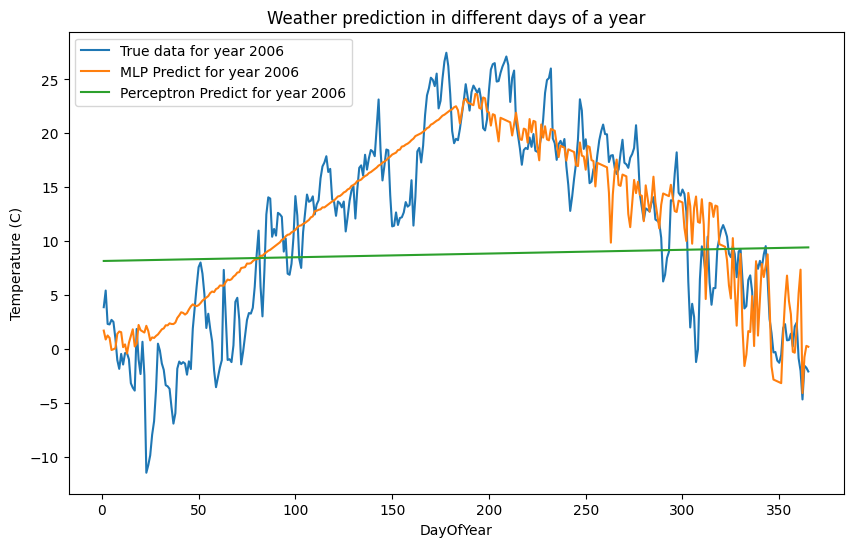

In [64]:
plt.figure(figsize=(10,6))
plt.plot(a['DayOfYear'],a['Temperature (C)'],label=f'True data for year 2006')
Y_pred=np.array(Y_pred)
Y_pred=Y_pred.reshape(365,1)
plt.plot(a['DayOfYear'],Y_pred[:,0],label=f'MLP Predict for year 2006')
plt.plot(a['DayOfYear'],Y_pred_perceptron,label=f'Perceptron Predict for year 2006')
plt.title('Weather prediction in different days of a year')
plt.ylabel('Temperature (C)')
plt.xlabel('DayOfYear')
plt.legend()
plt.show()